<a href="https://colab.research.google.com/github/Khaled-Mohammed-Abdelgaber/DR-mostafa/blob/main/preprocessing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
!pip install py-ecg-detectors # will used to detect QRS

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 554 kB 7.4 MB/s 
  Created wheel for gatspy: filename=gatspy-0.3-py3-none-any.whl size=43818 sha256=e12c81fdc29e29b74d3717e19d07c9f23e7741ee7947d456887acb20fcca32bc
  Stored in directory: /root/.cache/pip/wheels/13/7e/da/8944bc12def4de5f19b70d9c35634f78cbe6640907ff2e71ba
Successfully built gatspy


In [139]:
!pip install hdbscan

  Created wheel for hdbscan: filename=hdbscan-0.8.29-cp38-cp38-linux_x86_64.whl size=2700868 sha256=45a23719aa9616682876891a0ccbecbc72f1cd8fb0ad6a2891346c2738aa2770
  Stored in directory: /root/.cache/pip/wheels/76/06/48/527e038689c581cc9e519c73840efdc7473805149e55bd7ffd
Successfully built hdbscan


In [140]:
#to read csv files
import pandas as pd 

#to manipulate data
import numpy as np

#for ploting
import matplotlib.pyplot as plt
import seaborn as sns     

from scipy.fftpack import fft, fftfreq, ifft
from scipy.spatial.distance import cdist
from scipy import signal , stats
from sklearn import preprocessing
import numpy as np
from ecgdetectors import Detectors

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.cm as cm

from sklearn.cluster import DBSCAN 
import hdbscan
from sklearn.neighbors import NearestNeighbors


from sklearn.mixture import GaussianMixture
from matplotlib import pyplot

import warnings
warnings.filterwarnings("ignore")

# functions and classes definitions

In [4]:
def csv_id_reader(id,file="signals"):
  """
  this function recieve subject id and wanted file then return dataframe
  that is just reading csv or text file of that file.
  Separate CSV files are provided for each recording (where ## is the subject number), containing:

  bidmc_##_Breaths.csv: Manual breath annotations
  bidmc_##_Signals.csv: Physiological signals
  bidmc_##_Numerics.csv: Physiological parameters
  bidmc_##_Fix.txt: Fixed variables 
  """
  if id<10:
    if file == "breath":
      path = "/content/gdrive/MyDrive/bidmc_csv/bidmc_0"+str(id)+"_Breaths.csv"
    elif file == "fix":
      path = "/content/gdrive/MyDrive/bidmc_csv/bidmc_0"+str(id)+"_Fix.txt"
    elif file == "numerics":
      path = "/content/gdrive/MyDrive/bidmc_csv/bidmc_0"+str(id)+"_Numerics.csv"
    else:
      path = "/content/gdrive/MyDrive/bidmc_csv/bidmc_0"+str(id)+"_Signals.csv"
  else:
    if file == "breath":
      path = "/content/gdrive/MyDrive/bidmc_csv/bidmc_"+str(id)+"_Breaths.csv"
    elif file == "fix":
      path = "/content/gdrive/MyDrive/bidmc_csv/bidmc_"+str(id)+"_Fix.txt"
    elif file == "numerics":
      path = "/content/gdrive/MyDrive/bidmc_csv/bidmc_"+str(id)+"_Numerics.csv"
    else:
      path = "/content/gdrive/MyDrive/bidmc_csv/bidmc_"+str(id)+"_Signals.csv"

  df = pd.read_csv(path)
  return df

In [5]:
def hr(id):
  """this function takes the subject id and return 
   shortest beat interval, longest , and mean """
  df = csv_id_reader(id,"numerics")
  columns = df.columns
  max = df[' HR'].max()
  min = df[' HR'].min()
  mean = df[' HR'].mean()
  return 60/max , 60/min , 60/mean 

In [6]:
def normalizer(beat):
  """this function used to normalize amplitude of beat from 0 to 1""" 
  scaler = preprocessing.MinMaxScaler(feature_range=(0,1))
  d = scaler.fit_transform(np.array(beat).reshape(-1,1))
  return d.reshape(-1,)


In [7]:
def ppg_ecg_plotter(id,start = 0 , stop = 500):
  """this function is used to plot part of ecg and ppg signals of specific subject """
  df = csv_id_reader(id)
  plt.plot(df['Time [s]'][start:stop],df[' II'][start:stop])
  plt.plot(df['Time [s]'][start:stop],df[' PLETH'][start:stop])

In [8]:
def segment(ecg, ppg, fs, segment_len):
  """
  this function takes ppg and ecg signals 
  sampling frequency
  segment length in seconds
  and return 1d signal of that signals
  """
  ecg = np.reshape(ecg, (-1, segment_len*fs))
  ppg = np.reshape(ppg, (-1, segment_len*fs))
  return ecg, ppg

In [9]:
def extract(ppg, fs):
    """this function takes ppg dataframe and sampling frequency and 
    return the detected peaks"""

    # filter
    fn = fs / 2
    fl = 0.5 #lower cut off frequency
    fh = 10  #higher cut off frequency

    window_peak = int(fs * 0.111) #window to detect ppg peak within
    window_beat = int(fs * 0.667) #window to to detect ppg beat within

    beta = 0.02
    
    b, a = signal.cheby2(2, 20, [fl / fn, fh / fn], 'bandpass') #return filter coefficients 
    ppg_filtered = signal.filtfilt(b, a, ppg)

    ppg_clipped = ppg_filtered.copy() #make a copy of filtered ppg signal to prevent the orignal one from changing
    ppg_clipped[ppg_clipped < 0] = 0  #clipping to make all negative values in signal = 0

    ppg_square = ppg_clipped * ppg_clipped  # square 

    # peak average
    mean_peak = pd.Series(ppg_square).rolling(window=window_peak).mean()

    for index in range(window_peak):
        mean_peak[index] = sum(ppg_square[0:index]) / (index + 1)

    # beat average
    mean_beat = pd.Series(ppg_square).rolling(window=window_beat).mean()

    for index in range(window_beat):
        mean_beat[index] = sum(ppg_square[0:index]) / (index + 1)
    z = np.mean(ppg_square)
    # find the block of interest
    alpha = beta * z
    thr1 = mean_beat + alpha
    block_of_interest = np.zeros(len(mean_peak), dtype=np.int)
    block_onset = []
    block_end = []
    for index in range(len(block_of_interest)):
        if mean_peak[index] > thr1[index]:
            block_of_interest[index] = 1
            if index > 0:
                if mean_peak[index-1] <= thr1[index-1]:
                    block_onset.append(index)
        else:
            if len(block_onset) > 0:
                if mean_peak[index-1] > thr1[index-1]:
                    block_end.append(index)

    peaks = []
    for index in range(len(block_end)):
        if block_end[index] - block_onset[index] > window_peak:
            segment = ppg_square[block_onset[index]:block_end[index]]
            peaks.append(np.argmax(segment) + block_onset[index])

    return peaks

In [10]:
def correctPeaks(peak, ECG, window):
    """this function used to correct detected peaks from ecg signals
    takes peaks location and ecg signal also take window to search within"""
    peak_c = peak
    for index in range(len(peak)):
        start_loc = max(1, peak[index]-window)
        end_loc = min(len(ECG), peak[index]+window)
        segment = ECG[start_loc:end_loc]
        loc = np.argmax(segment)
        peak_c[index] = loc + start_loc
    return peak_c

In [11]:
def alignment(ECG, r_peak, ppg, speak, Fs):
    for index in range(2, len(speak)):
        flag = 0
        previouspeak = [x for x in r_peak if x < speak[index]]
        for i2 in range(len(previouspeak)-1, 0, -1):
            rrinterval = r_peak[i2 + 1] - r_peak[i2]
            ppinterval = speak[index + 1] - speak[index]
            if abs(ppinterval - rrinterval) <= 0.05 * Fs:
                n = i2
                flag = 1
                break
        if flag == 1:
            break
    shiftpoint = speak[index] - r_peak[i2]
    ecg_algined = ECG[1:len(ECG)-shiftpoint]
    ppg_aligned = ppg[shiftpoint+1:len(ppg)]
    return ecg_algined, ppg_aligned

In [12]:
def signal_preprocessing(ecg, ppg, Fs, ecg_fh, ppg_fh):
    """
    this function used to filter ecg signal and ppg signal using chebychev filter
    it takes sampling frequency, highest cutoff frequency for ecg and ppg
    algorithm used to detect peaks of ecg is pan tompkins 
    for ppg signal is block algorithm
     """
    fl = 0.5
    fn = Fs / 2
    detectors = Detectors(Fs)
    b, a = signal.cheby2(4, 20, [fl / fn, ecg_fh / fn], 'bandpass')

    ecg_filtered = signal.filtfilt(b, a, ecg)

    r_peak = detectors.pan_tompkins_detector(ecg)

    r_peak = correctPeaks(r_peak, ecg_filtered, 15)

    b, a = signal.cheby2(4, 20, [fl / fn, ppg_fh / fn], 'bandpass')

    ppg_filtered = signal.filtfilt(b, a, ppg)

    systolicPeak = extract(ppg, Fs)

    systolicPeak = correctPeaks(systolicPeak, ppg_filtered, 15)
    
    return np.array(ecg_filtered) , np.array(ppg_filtered), np.array(systolicPeak) , np.array(r_peak)

In [13]:
def rescale(arr, no_samples):
    """this function is used to resize a given array [signal] to specific number of smaples"""
    n = len(arr)
    factor = float(no_samples)/n
    return np.interp(np.linspace(0, n, int(factor*n+1)), np.arange(n), arr)[:-1]

In [14]:
def segmenter(np_peaks,signal,normalize = False ,length=127):
  """
  this function takes a signal and its peaks and return a stacked beats each of length 128 if input length is 127
  if normalize is True the returned beats is normalized to scale from 0 to 1"""
  beats_lst = []
  beats_interval = []
  id = []
  for i in range(len(np_peaks)-1):
    beat = np.array(signal[np_peaks[i]:np_peaks[i+1]])
    beat = rescale(beat,length)
    if normalize:
      beat = normalizer(beat)
    beats_interval.append((np_peaks[i+1] - np_peaks[i])/125.0)
    beats_lst.append(beat)
  return np.array(beats_lst) , np.array(beats_interval)


In [15]:
def csv_beats_producer_single( id , sampling_freq=125 , ecg_fh=30 , ppg_fh=10 , beat_length=128):
  """
  just all together for single person
  ### input: person id , sampling frequency , ecg highest cutoff frequency, ppg highest cutoff frequency , beat length
  ### output: 4 dataframes for person id for each beat, each beat interval, each beat ppg and respective ecg part
  """
  ecg = csv_id_reader(id)[" II"]
  ppg = csv_id_reader(id)[' PLETH']

  ecg_filtered, ppg_filtered, systolicPeak, r_peak = signal_preprocessing(ecg, ppg, sampling_freq, ecg_fh, ppg_fh)
  """print("shape of ecg_filtered is ",ecg_filtered.shape)
  print("shape of ppg_filtered is ",ppg_filtered.shape)
  print("number of ppg beats is ",systolicPeak.shape[0]-1)"""
 

  filtered_beats_ppg, filtered_beats_ppg_intervals = segmenter(systolicPeak,ppg_filtered,True,beat_length)
  """print("number of ppg beats and length of each is ",filtered_beats_ppg.shape)
  print("length of beat interval array is ",filtered_beats_ppg_intervals.shape)"""

  filtered_beats_ecg,_ = segmenter(systolicPeak,ecg_filtered,False,beat_length)
  """print("number of ecg beats is ",filtered_beats_ecg.shape)"""

  df_ppg_beats = pd.DataFrame(data = filtered_beats_ppg , columns = np.arange(128))
  df_ecg_beats = pd.DataFrame(data = filtered_beats_ecg , columns = np.arange(128))

  df_beat_interval = pd.DataFrame(data = filtered_beats_ppg_intervals, columns = ['beat_interval'])
  df_person_id = pd.DataFrame(data = np.ones(len(filtered_beats_ppg))*id,columns = ['id'])

  return df_ppg_beats , df_ecg_beats , df_beat_interval , df_person_id


In [16]:
def signals_concatenators( ids , sampling_freq=125 , ecg_fh=30 , ppg_fh=10 , beat_length=128):
  """
  just all together for multiple persons
  ### input: persons ids , sampling frequency , ecg highest cutoff frequency, ppg highest cutoff frequency , beat length
  ### output: 4 dataframes for person id for each beat, each beat interval, each beat ppg and respective ecg part
  """
  ppg_beats = pd.DataFrame()
  ecg_beats = pd.DataFrame()
  persons_id = pd.DataFrame()
  beats_intervals = pd.DataFrame()
  
  for id in ids:
    df_ppg_beats , df_ecg_beats , df_beat_interval , df_person_id = csv_beats_producer_single(id,sampling_freq , ecg_fh, ppg_fh , beat_length)
    ppg_beats = pd.concat([ppg_beats, df_ppg_beats], axis=0)
    ecg_beats = pd.concat([ecg_beats, df_ecg_beats], axis=0)
    persons_id = pd.concat([persons_id, df_person_id], axis=0)
    beats_intervals = pd.concat([beats_intervals, df_beat_interval], axis=0)
  return ppg_beats , ecg_beats  , beats_intervals, persons_id


In [17]:
def hr_checker(ppg_beats):
  larger_beats = np.zeros(ppg_beats.shape[0])
  smaller_beats = np.zeros(ppg_beats.shape[0])
  start = 0  
  stop = 0 
  for id in range(1,54):
    start = stop 
    stop = np.where(persons_id.values == id)[0]
    larger_beats[stop] = ((beats_intervals.values[stop]) > (hr(id)[1]+0.21)).reshape(-1,)
    smaller_beats[stop]= ((beats_intervals.values[stop]) < (hr(id)[0]-0.21)).reshape(-1,)
  return larger_beats , smaller_beats

In [18]:
def getDistanceByPoint(data, model,df_bool = True):
  distance = pd.Series()
  if df_bool:
    for i in range(0,len(data)):
        Xa = np.array(data.loc[i]) #give the point dimensions
        Xb = model.cluster_centers_[model.labels_[i]-1] # gives the center of cluster that sample belong to
        distance.at[i]=np.linalg.norm(Xa-Xb)
  else:
    for i in range(0,len(data)):
      Xa = np.array(data[i]) #give the point dimensions
      Xb = model.cluster_centers_[model.labels_[i]-1] # gives the center of cluster that sample belong to
      distance.at[i]=np.linalg.norm(Xa-Xb)

  return distance

# preprocessing body

In [19]:
def person_cleaner(id ,ratio):
  outliers_fraction = ratio
  ppg_beats , ecg_beats  , beats_intervals, persons_id = signals_concatenators(id)
  kmeans = KMeans(n_clusters=1)
  kmeans.fit(ppg_beats.values)
  cluster_labels = kmeans.labels_  
  df = pd.DataFrame() 
  distance = getDistanceByPoint(ppg_beats.values , kmeans,0) #just a series contain distance between each point and its center
  number_of_outliers = int(outliers_fraction*len(distance))#allowed number of outliers from total datasets
  threshold = distance.nlargest(number_of_outliers).min() # obtain the threshold 
  df['anomaly1'] = (distance >= threshold).astype(int)
  outliers_indexes = np.where(df.values == 1)[0]

  return ppg_beats.drop(labels = outliers_indexes , axis = 0) , ecg_beats.drop(labels = outliers_indexes , axis = 0), beats_intervals.drop(labels = outliers_indexes , axis = 0) , persons_id.drop(labels = outliers_indexes , axis = 0),outliers_indexes


In [20]:
def remove_outliers(df,columns,n_std):
    for col in columns:
        #print('Working on column: {}'.format(col))
        mean = df[col].mean()
        sd = df[col].std()
        df = df[(df[col] <= mean+(n_std*sd))|(df[col] <= mean-(n_std*sd))]
    return df

In [50]:
def remove_outliers_using_pca(ppg,n_std,n_pca = 2):
  pca = PCA(n_components = n_pca)
  pca_values = pca.fit_transform(ppg)
  pca_df = pd.DataFrame(data = pca_values , columns = np.arange(n_pca))
  plt.figure();
  plt.scatter(pca_values[:,0],pca_values[:,1])
  plt.scatter(pca_values[:,0].mean(),pca_values[:,1].mean(),c='r')
  plt.scatter(pca_values[:,0].mean()+n_std*pca_values[:,0].std(),pca_values[:,1].mean()+n_std*pca_values[:,1].std(),c='g')
  plt.scatter(pca_values[:,0].mean()-n_std*pca_values[:,0].std(),pca_values[:,1].mean()-n_std*pca_values[:,1].std(),c='g')
  for col in pca_df.columns:
        #print('Working on column: {}'.format(col))
        mean = pca_df[col].mean()
        sd = pca_df[col].std()
        ppg = ppg[(pca_df[col] <= mean+(n_std*sd))|(pca_df[col] <= mean-(n_std*sd))]
  return ppg

In [135]:
def remove_outliers_using_dbscan(ppg):
  pca = PCA(n_components = 2)
  pca_values = pca.fit_transform(ppg)
  pca_df = pd.DataFrame(data = pca_values , columns = np.arange(2))

  neigh = NearestNeighbors(n_neighbors=2)
  nbrs = neigh.fit(pca_values)
  distances, indices = nbrs.kneighbors(pca_values)
  distances = np.sort(distances, axis=0)
  distances = distances[:,1]
  eps_optim = distances.max()
  """print("****************************************")
  print(eps_optim)
  print("****************************************")

  plt.figure(figsize=(20,10))
  plt.plot(distances)
  plt.title('K-distance Graph',fontsize=20)
  plt.xlabel('Data Points sorted by distance',fontsize=14)
  plt.ylabel('Epsilon',fontsize=14)
  plt.show()"""

  dbscan=DBSCAN(eps = eps_optim,min_samples=3)
  dbscan.fit(pca_df)
  colors = dbscan.labels_
  plt.scatter(pca_df.iloc[:,0], pca_df.iloc[:,1], c = colors)


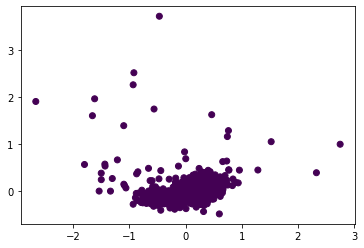

In [136]:
ppg_beats  = csv_beats_producer_single(1)[0]
remove_outliers_using_dbscan(ppg_beats)

In [265]:
def remove_outliers_using_hdbscan(ppg,id):
  pca = PCA(n_components = 2)
  pca_values = pca.fit_transform(ppg)
  pca_df = pd.DataFrame(data = pca_values , columns = np.arange(2))
  clusterer = hdbscan.HDBSCAN(min_cluster_size=200,min_samples = 20).fit(pca_values)
  if id in [38,12,14,17,23,28,29,41,43,44,45,53]:
    ratio = 0.85
  elif (id == 40) | (id == 26):
    ratio = 0.65
  elif id in [35,2,10]:
    ratio = 0.7
  else :
    ratio = 0.93
  threshold = pd.Series(clusterer.outlier_scores_).quantile(ratio)
  outliers = np.where(clusterer.outlier_scores_ > threshold)[0]
  plt.figure();
  plt.plot(ppg.values.T);
  plt.title("original id = "+str(id));
  plt.figure();
  plt.plot(ppg.values[np.where(clusterer.outlier_scores_ < threshold)[0]].T);
  plt.title("cleaned number of outliers = "+str(outliers.shape[0]))

  plt.figure();
  plt.scatter(*pca_values.T, s=50, linewidth=0, c='yellow',alpha = 0.5)
  plt.scatter(*pca_values[outliers].T, s=50, linewidth=0, c='red',alpha = 0.5)

1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 

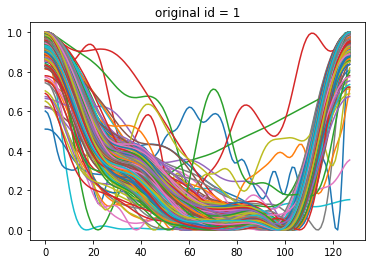

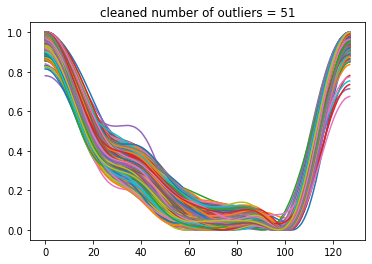

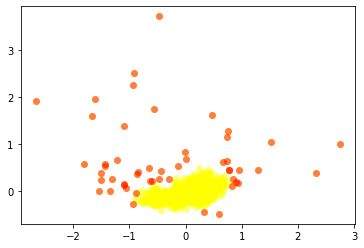

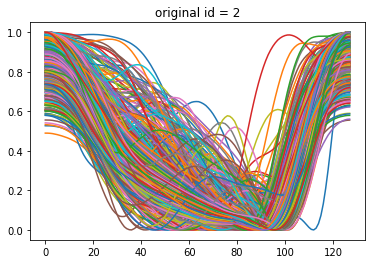

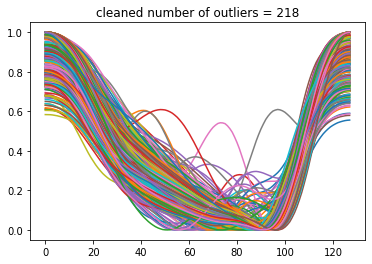

...

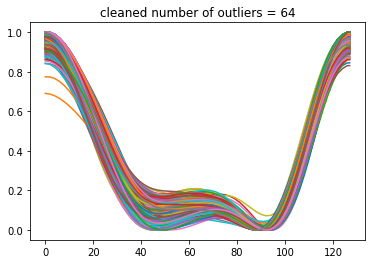

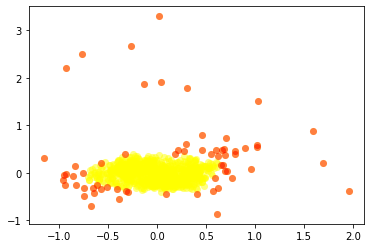

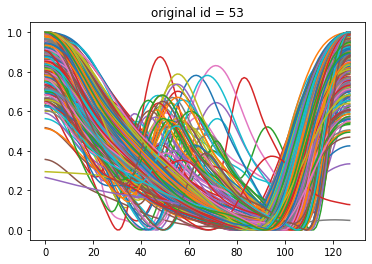

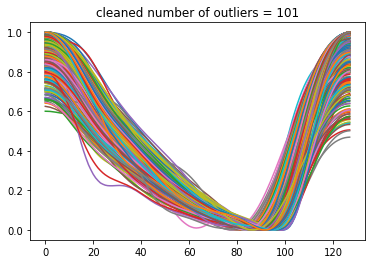

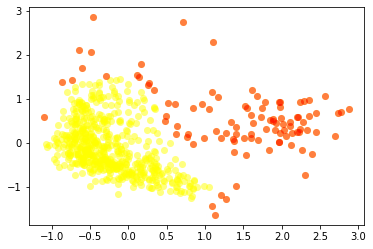

In [266]:
for i in range(1,54):
  print(i,end = " ")
  ppg_beats  = csv_beats_producer_single(i)[0]
  remove_outliers_using_hdbscan(ppg_beats,i)

10 12 14 17 23 26 28 29 35 40 41 53 

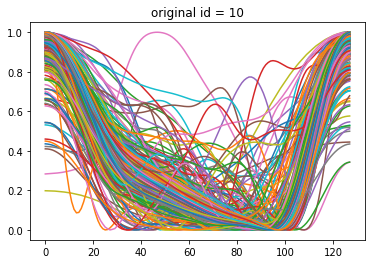

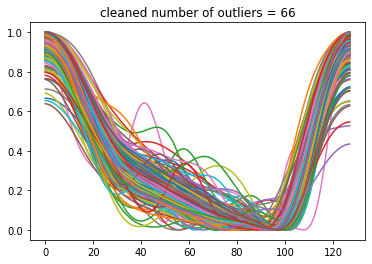

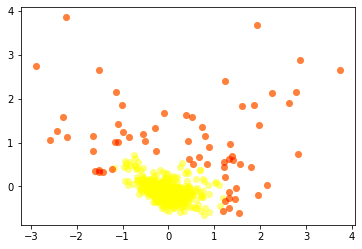

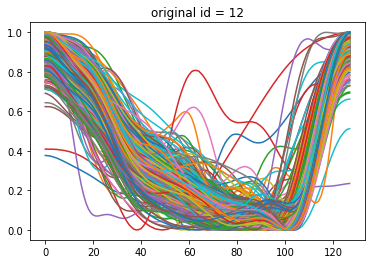

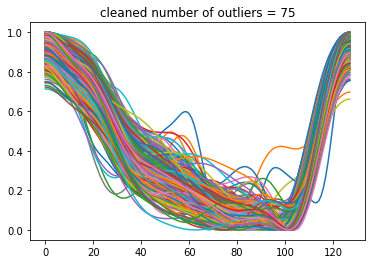

...

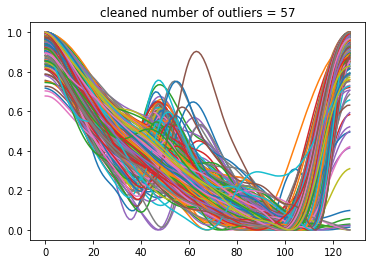

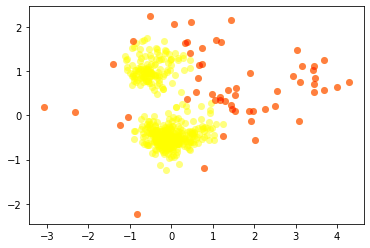

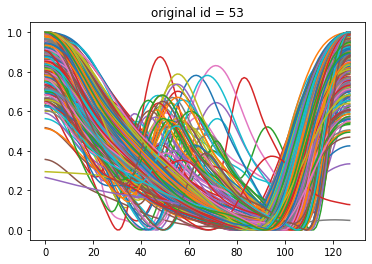

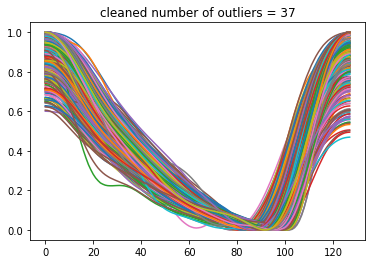

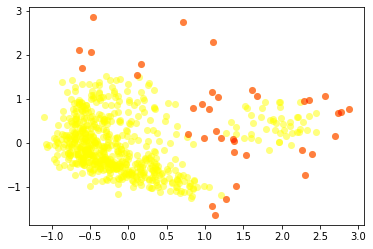

In [192]:
for i in [10,12,14,17,23,26,28,29,35,40,41,53]:
  print(i,end = " ")
  ppg_beats  = csv_beats_producer_single(i)[0]
  remove_outliers_using_hdbscan(ppg_beats,i)

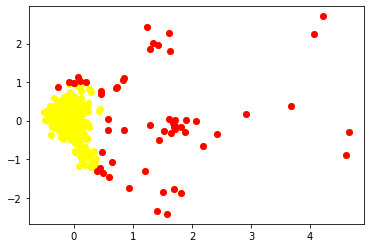

In [172]:
ppg_beats  = csv_beats_producer_single(4)[0]
remove_outliers_using_hdbscan(ppg_beats)

**************************************************
Total number of outliers in datasets are 202
**************************************************


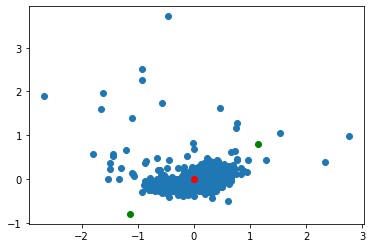

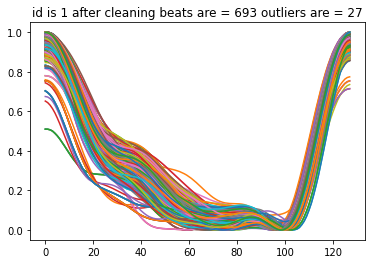

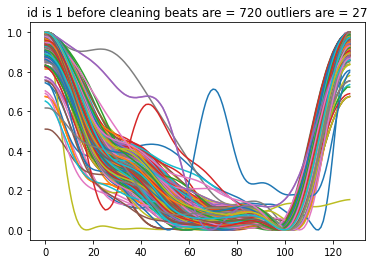

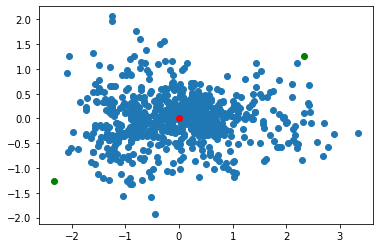

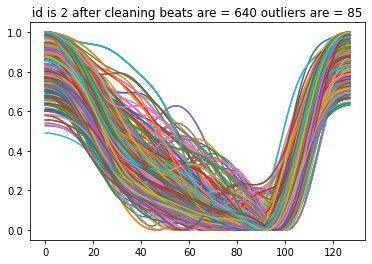

...

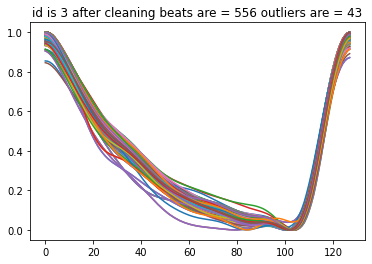

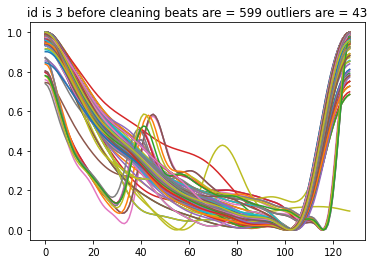

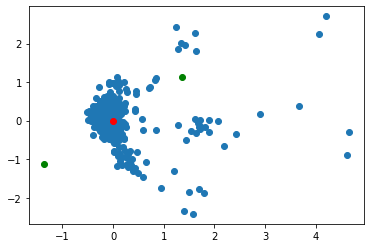

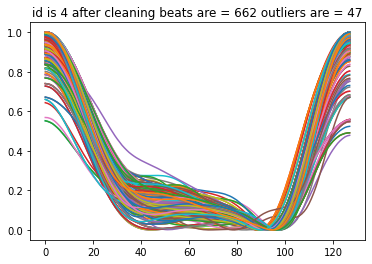

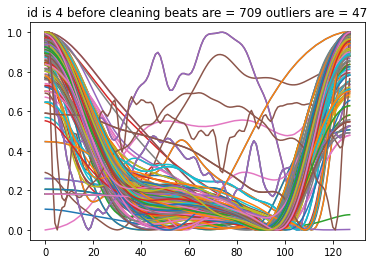

In [81]:
total = 0
for id in range(1,5):
  ppg_beats  = csv_beats_producer_single(id)[0]
  if id in [17,24,26,28,33,41,40,45]:
    std_multiplier = 2.0
  else:
    std_multiplier = 2.5
  clean_ppg_beats =  remove_outliers_using_pca(ppg_beats,std_multiplier,10)
  #print(f"id is {id} cleaned beats are = {clean_ppg_beats.shape[0]} outliers are = {ppg_beats.shape[0] -clean_ppg_beats.shape[0] }")
  plt.figure();
  rc = np.random.randint(0,clean_ppg_beats.shape[0],clean_ppg_beats.shape[0])
  ro = np.random.randint(0,ppg_beats.shape[0],ppg_beats.shape[0])
  total = total +(ppg_beats.shape[0] - clean_ppg_beats.shape[0])
  for i in rc:
    plt.plot(clean_ppg_beats.iloc[i,:].values);
    #plt.title(f"id is {id} cleaned");
    plt.title(f"id is {id} after cleaning beats are = {clean_ppg_beats.shape[0]} outliers are = {ppg_beats.shape[0] -clean_ppg_beats.shape[0] }");
  plt.figure();
  for i in ro:
    plt.plot(ppg_beats.iloc[i,:].values);
    #plt.title(f"id is {id}with outliers");
    plt.title(f"id is {id} before cleaning beats are = {ppg_beats.shape[0]} outliers are = {ppg_beats.shape[0] -clean_ppg_beats.shape[0] }");

print("*"*50)
print(f"Total number of outliers in datasets are {total}")
print("*"*50)

**************************************************
Total number of outliers in datasets are 5070
**************************************************


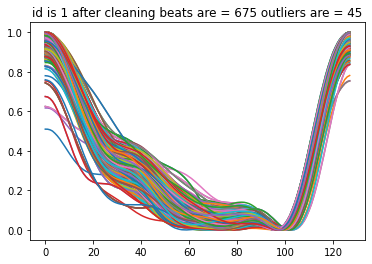

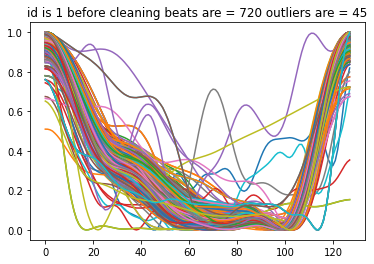

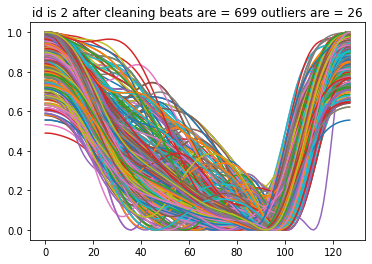

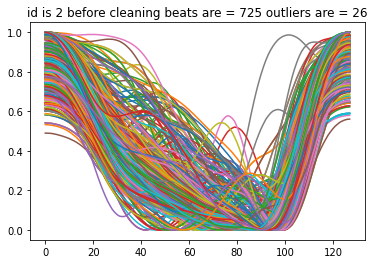

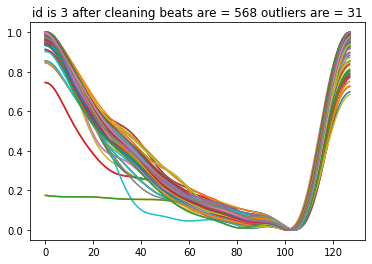

...

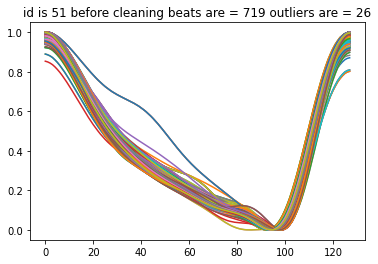

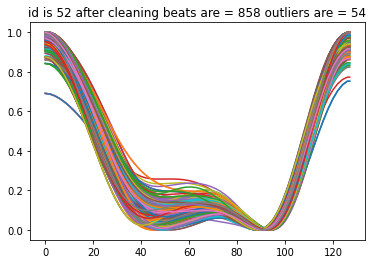

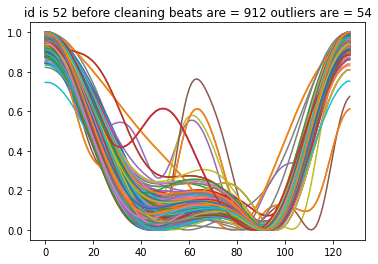

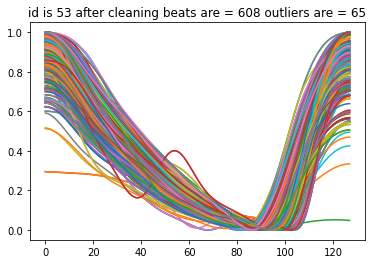

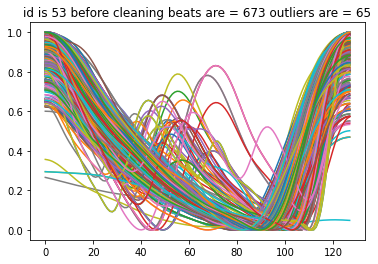

In [38]:
total = 0
for id in range(1,54):
  ppg_beats  = csv_beats_producer_single(id)[0]
  if id in [17,24,26,28,33,41,40,45]:
    std_multiplier = 2
  else:
    std_multiplier = 4.5
  clean_ppg_beats =  remove_outliers(ppg_beats,ppg_beats.columns,std_multiplier)
  #print(f"id is {id} cleaned beats are = {clean_ppg_beats.shape[0]} outliers are = {ppg_beats.shape[0] -clean_ppg_beats.shape[0] }")
  plt.figure();
  rc = np.random.randint(0,clean_ppg_beats.shape[0],clean_ppg_beats.shape[0])
  ro = np.random.randint(0,ppg_beats.shape[0],ppg_beats.shape[0])
  total = total +(ppg_beats.shape[0] - clean_ppg_beats.shape[0])
  for i in rc:
    plt.plot(clean_ppg_beats.iloc[i,:].values);
    #plt.title(f"id is {id} cleaned");
    plt.title(f"id is {id} after cleaning beats are = {clean_ppg_beats.shape[0]} outliers are = {ppg_beats.shape[0] -clean_ppg_beats.shape[0] }");
  plt.figure();
  for i in ro:
    plt.plot(ppg_beats.iloc[i,:].values);
    #plt.title(f"id is {id}with outliers");
    plt.title(f"id is {id} before cleaning beats are = {ppg_beats.shape[0]} outliers are = {ppg_beats.shape[0] -clean_ppg_beats.shape[0] }");

print("*"*50)
print(f"Total number of outliers in datasets are {total}")
print("*"*50)

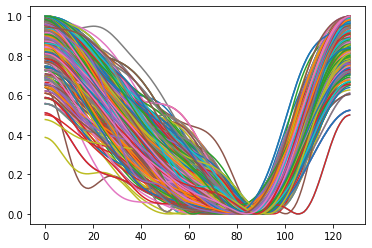

In [ ]:
for id in range(1,54):
  ppg_beats , ecg_beats  , beats_intervals, persons_id = signals_concatenators([id])
  #clean_ppg_beats , clean_ecg_beats  , clean_beats_intervals, clean_persons_id , outliers = person_cleaner([id],0.05)
  print(clean_ppg_beats.shape , ppg_beats.shape , outliers.shape)

  for i in outliers[:36]:
    plt.figure();
    plt.plot(ppg_beats.iloc[i,:].values.T);

In [ ]:

cluster_id =0
df = pd.DataFrame()

# get the distance between each point and its nearest centroid. The biggest distances are considered as anomaly

number_of_outliers = int(outliers_fraction*len(distance))#allowed number of outliers from total datasets

threshold = 2#distance.nlargest(number_of_outliers).min() # obtain the threshold 

print("threshold of outliers distance is ",threshold)
# anomaly1 contain the anomaly result of the above method Cluster (0:normal, 1:anomaly)
df['anomaly1'] = (distance >= threshold).astype(int)


"""
fig, ax = plt.subplots(figsize=(10,6))
colors = {0:'blue', 1:'red'}
ax.scatter(pca_values[cluster_labels == cluster_id,0], pca_values[cluster_labels == cluster_id,1], c=df["anomaly1"].apply(lambda x: colors[x]))
plt.xlabel('principal feature1')
plt.ylabel('principal feature2')
plt.show();

"""



outliers_indexes = np.where(df.values == 1)[0]

print(outliers_indexes.shape)
index = np.random.randint(0,outliers_indexes.shape[0],outliers_indexes.shape[0])
plt.figure();
clusters = np.zeros(20)
for i in index:
  clusters[cluster_labels[outliers_indexes[i]]] +=1
  print(outliers_indexes[i])
  print("distanc from center = ",distance[outliers_indexes[i]])
  plt.figure();#plt.subplot(2,5,f+1)
  plt.plot(ppg_beats.loc[cluster_labels == cluster_id].iloc[outliers_indexes[i],:]);
  plt.title(str(cluster_labels[cluster_labels == cluster_id][outliers_indexes[i]]) + " " + str(distance[outliers_indexes[i]]))

In [ ]:
ppg_beats.shape , ecg_beats.shape  , beats_intervals.shape, persons_id.shape 

((720, 128), (720, 128), (720, 1), (720, 1))

In [ ]:
ecg_beats.head() 

,0,1,2,3,4,5,6,7,8,9,...,118,119,120,121,122,123,124,125,126,127
0,-0.214072,-0.128562,0.027119,0.288058,0.588583,0.865172,1.006434,0.985596,0.856690,0.560285,...,-0.101563,-0.110126,-0.111451,-0.086239,-0.066343,-0.054419,-0.085376,-0.130344,-0.188468,-0.211717
1,-0.141632,0.084473,0.352268,0.677692,0.905510,1.044215,0.981628,0.767674,0.480824,0.181748,...,-0.158822,-0.158243,-0.139782,-0.106095,-0.084415,-0.091661,-0.144162,-0.208376,-0.251006,-0.268901
2,-0.085821,0.201647,0.496272,0.802588,0.956805,1.025066,0.859713,0.623050,0.320295,0.085292,...,-0.093426,-0.113247,-0.135314,-0.139656,-0.129211,-0.102811,-0.086224,-0.084697,-0.125721,-0.141299
3,-0.242362,-0.208222,-0.103194,0.108166,0.399584,0.689823,0.895286,0.948730,0.900826,0.646204,...,-0.098406,-0.114227,-0.134731,-0.137907,-0.129748,-0.104583,-0.086313,-0.080497,-0.117602,-0.132444
4,-0.234322,-0.210694,-0.107861,0.096178,0.402548,0.694085,0.923060,0.953698,0.874743,0.607634,...,-0.150218,-0.131495,-0.098157,-0.093555,-0.111032,-0.175360,-0.227661,-0.255354,-0.146078,-0.098103


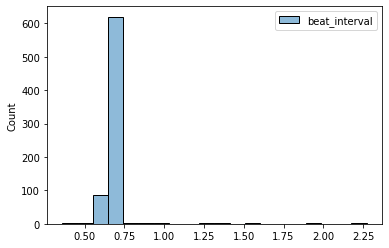

In [ ]:
sns.histplot(beats_intervals,bins = 20)

In [ ]:
csv_beats_producer_single.__doc__

'\n  just all together for single person\n  ### input: person id , sampling frequency , ecg highest cutoff frequency, ppg highest cutoff frequency , beat length\n  ### output: 4 dataframes for person id for each beat, each beat interval, each beat ppg and respective ecg part\n  '

In [ ]:
for id in range(1,2):
  df_ppg_beats , df_ecg_beats , df_beat_interval , df_person_id = csv_beats_producer_single(id)
  plt.figure();
  sns.histplot(df_beat_interval,bins=10);
  plt.figure();
  for i in np.where(df_beat_interval.values > (df_beat_interval.values.mean()+df_beat_interval.values.std()))[0]:
    plt.figure();
    plt.plot(df_ecg_beats.iloc[i,:])
    plt.figure();
    plt.plot(df_ppg_beats.iloc[i,:])

In [ ]:
for id in [33, 4 ,32,3,13,15]:
  print("person id is ",id)
  ecg = csv_id_reader(id)[" II"]
  ppg = csv_id_reader(id)[' PLETH']
  ecg_filtered, ppg_filtered, systolicPeak, r_peak = signal_preprocessing(ecg, ppg, 125, 30, 8)

  filtered_beats_ppg = segmenter(systolicPeak,ppg_filtered,1,128)[0]
  or_beats_ppg =  segmenter(systolicPeak,ppg,1,128)[0]

  filtered_beats_ecg = segmenter(r_peak,ecg_filtered,0,128)[0]
  or_beats_ecg =  segmenter(r_peak,ecg,0,128)[0]

  print(len(filtered_beats_ppg))
  print(len(filtered_beats_ecg))

  indexes = np.random.randint(1,400,10)
  plt.figure();
  for i in indexes:
    plt.plot(filtered_beats_ppg[i]);
    plt.title("filtered beats");


  plt.figure();
  for i in indexes:
    plt.plot(or_beats_ppg[i]);
    plt.title("original beats");


  plt.figure();

  for i in indexes:
    plt.plot(filtered_beats_ecg[i]);
    plt.title("filtered beats");


  plt.figure();
  for i in indexes:
    plt.plot(or_beats_ecg[i]);
    plt.title("original beats");

  wave_range = np.random.randint(0,50500,1)[0]

  plt.figure();
  plt.plot(ppg[wave_range:wave_range+500]);
  plt.title("original signal");

  plt.figure();
  plt.plot(ecg[wave_range:wave_range+500]);
  plt.title("original signal");


In [ ]:
id = np.random.randint(1,52,1)[0]
print("person id is ",id)
ecg = csv_id_reader(id)[" II"]
ppg = csv_id_reader(id)[' PLETH']
ecg_filtered, ppg_filtered, systolicPeak, r_peak = signal_preprocessing(ecg, ppg, 125, 30, 8)

filtered_beats_ppg = segmenter(systolicPeak,ppg_filtered,128)[0]
or_beats_ppg =  segmenter(systolicPeak,ppg,128)[0]

filtered_beats_ecg = segmenter(r_peak,ecg_filtered,128)[0]
or_beats_ecg =  segmenter(r_peak,ecg,128)[0]

print(len(filtered_beats_ppg))
print(len(filtered_beats_ecg))

indexes = np.random.randint(1,500,10)

for i in indexes:
  plt.plot(filtered_beats_ppg[i]);
  plt.title("filtered beats")


plt.figure();
for i in indexes:
  plt.plot(or_beats_ppg[i]);
  plt.title("original beats")


plt.figure();

for i in indexes:
  plt.plot(filtered_beats_ecg[i]);
  plt.title("filtered beats")


plt.figure();
for i in indexes:
  plt.plot(or_beats_ecg[i]);
  plt.title("original beats")

wave_range = np.random.randint(0,50500,1)[0]

plt.figure();
plt.plot(ppg[wave_range:wave_range+500]);
plt.title("original signal");

plt.figure();
plt.plot(ecg[wave_range:wave_range+500]);
plt.title("original signal");

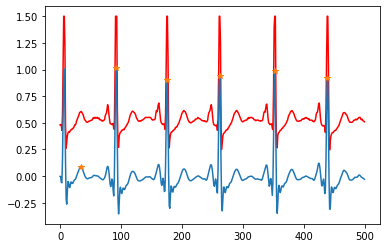

In [ ]:
r_peak = np.array(r_peak)
i = r_peak[np.where( r_peak < 500)[0]]
plt.plot(np.arange(500) ,ecg[:500],color = 'r')
plt.plot(np.arange(500) ,ecg_filtered[:500])
plt.plot(i,ecg_filtered[:500][i],'*')

# clustering and get ride of outliers

In [ ]:
ppg_beats= pd.read_csv("/content/gdrive/MyDrive/csv_beats_ppg_based_9_12_2022/ppg_beats.csv")
ecg_beats = pd.read_csv("/content/gdrive/MyDrive/csv_beats_ppg_based_9_12_2022/ecg_beats.csv")
beats_intervals = pd.read_csv("/content/gdrive/MyDrive/csv_beats_ppg_based_9_12_2022/beats_intervals.csv")
persons_id = pd.read_csv("/content/gdrive/MyDrive/csv_beats_ppg_based_9_12_2022/persons_id.csv")

In [ ]:
ppg_beats.drop(['Unnamed: 0'],axis = 1,inplace = True)
ecg_beats.drop(['Unnamed: 0'],axis = 1,inplace = True)
beats_intervals.drop(['Unnamed: 0'],axis = 1,inplace = True)
persons_id.drop(['Unnamed: 0'],axis = 1,inplace = True)

In [ ]:
ppg_beats.shape , ecg_beats.shape, beats_intervals.shape , persons_id.shape

((36824, 128), (36824, 128), (36824, 1), (36824, 1))

# Gaussian mixture

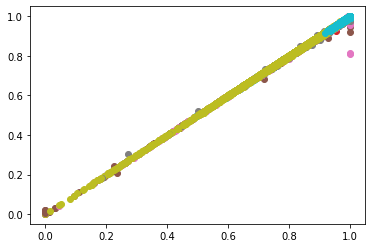

In [ ]:

# define dataset
X = ppg_beats.values
# define the model
model = GaussianMixture(n_components=20)
# fit the model
model.fit(ppg_beats.values)
# assign a cluster to each example
yhat = model.predict(ppg_beats.values)
# retrieve unique clusters
clusters = np.unique(yhat)
# create scatter plot for samples from each cluster
for cluster in clusters:
 # get row indexes for samples with this cluster
 row_ix = np.where(yhat == cluster)
 # create scatter of these samples
 pyplot.scatter(ppg_beats.values[row_ix, 0], ppg_beats.values[row_ix, 1])
# show the plot



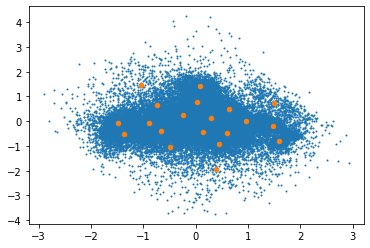

In [ ]:
import numpy as np
import matplotlib.pyplot as plt




gmm = GaussianMixture(n_components=20, covariance_type='full').fit(pca_values)

plt.scatter(pca_values[:,0], pca_values[:, 1], s = 1)


for i in range(gmm.n_components):
    density = stats.multivariate_normal(cov=gmm.covariances_[i], mean=gmm.means_[i]).logpdf(pca_values)
    centers[i, :] = pca_values[np.argmax(density)]
plt.scatter(centers[:, 0], centers[:, 1], s=20)
plt.show()

In [ ]:
clusters

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19])

number of cluster 0 is 3100
number of cluster 1 is 2171
number of cluster 2 is 1113
number of cluster 3 is 1403
number of cluster 4 is 434
number of cluster 5 is 2028
number of cluster 6 is 953
number of cluster 7 is 5953
number of cluster 8 is 2066
number of cluster 9 is 395
number of cluster 10 is 186
number of cluster 11 is 262
number of cluster 12 is 1836
number of cluster 13 is 1802
number of cluster 14 is 3372
number of cluster 15 is 5913
number of cluster 16 is 619
number of cluster 17 is 1805
number of cluster 18 is 41
number of cluster 19 is 1372


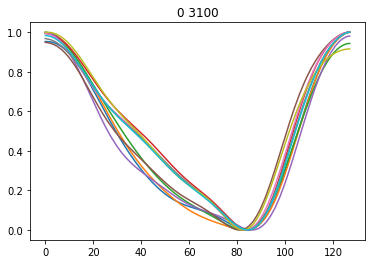

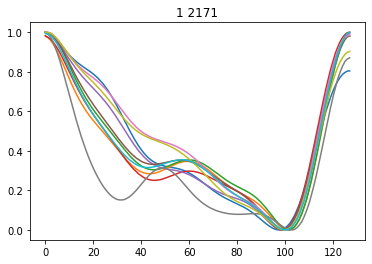

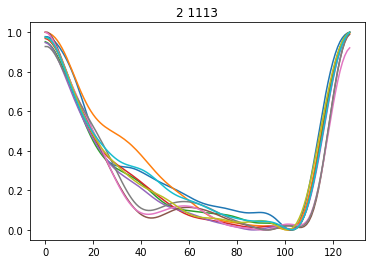

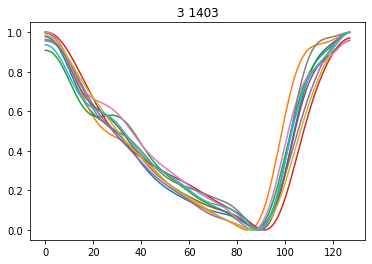

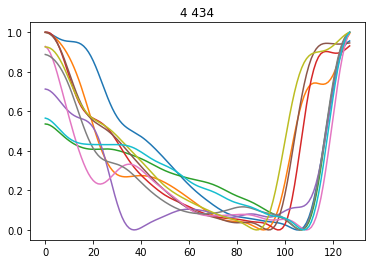

...

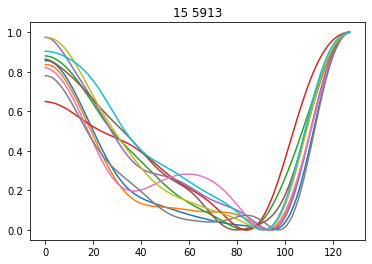

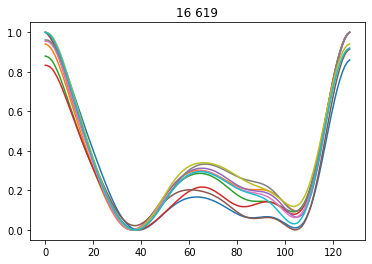

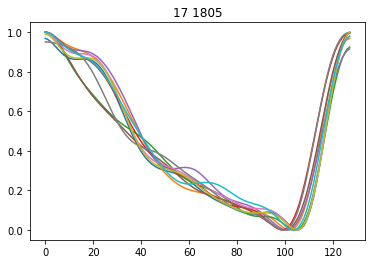

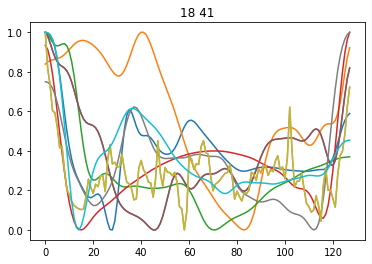

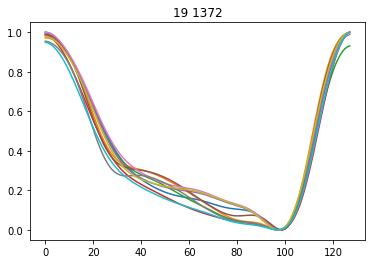

In [ ]:
for i in clusters:
  indexes = np.where(yhat == i)[0]
  rand = np.random.randint(0,indexes.shape[0],10)
  print(f"number of cluster {i} is {indexes.shape[0]}")
  plt.figure();
  plt.plot(ppg_beats.iloc[indexes[rand],:].values.T);
  plt.title(str(i)+" "+str(indexes.shape[0]))

# PCA

In [ ]:
pca = PCA(n_components=2)
pca_values = pca.fit_transform(ppg_beats)
pca.explained_variance_ratio_

array([0.4459195 , 0.21887464])

# Kmeans elbow

In [ ]:
distortions = []
inertias = []
mapping1 = {}
mapping2 = {}

K = range(1, 20)
for k in K:
    print(k)
    # Building and fitting the model
    kmeanModel = KMeans(n_clusters=k).fit(pca_values)
    kmeanModel.fit(pca_values)
  
    distortions.append(sum(np.min(cdist(pca_values, kmeanModel.cluster_centers_,
                                        'euclidean'), axis=1)) / pca_values.shape[0])
    inertias.append(kmeanModel.inertia_)
  
    mapping1[k] = sum(np.min(cdist(pca_values, kmeanModel.cluster_centers_,
                                   'euclidean'), axis=1)) / pca_values.shape[0]
    mapping2[k] = kmeanModel.inertia_

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19


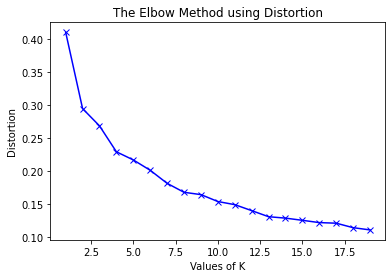

In [ ]:
plt.plot(K, distortions, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion')
plt.show()

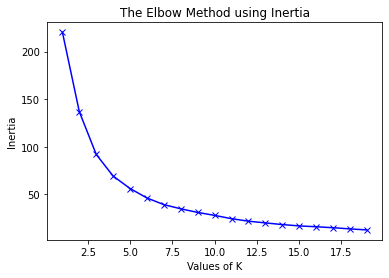

In [ ]:
plt.plot(K, inertias, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('The Elbow Method using Inertia')
plt.show()

#Kmeans Clustering

In [ ]:
kmeans = KMeans(n_clusters=1)
kmeans.fit(ppg_beats.values)
cluster_labels = kmeans.labels_   

number of datasets of cluster  0  =  720
color of cluster 0  is  [0.5 0.  1.  1. ]
number of datasets of cluster  1  =  0
color of cluster 1  is  [0.39803922 0.15947579 0.99679532 1.        ]
number of datasets of cluster  2  =  0
color of cluster 2  is  [0.29607843 0.31486959 0.98720184 1.        ]
number of datasets of cluster  3  =  0
color of cluster 3  is  [0.18627451 0.47309356 0.96979694 1.        ]
number of datasets of cluster  4  =  0
color of cluster 4  is  [0.08431373 0.60753895 0.94717736 1.        ]
number of datasets of cluster  5  =  0
color of cluster 5  is  [0.0254902  0.73484497 0.9160336  1.        ]
number of datasets of cluster  6  =  0
color of cluster 6  is  [0.12745098 0.83360239 0.88101219 1.        ]
number of datasets of cluster  7  =  0
color of cluster 7  is  [0.2372549  0.9160336  0.83698911 1.        ]
number of datasets of cluster  8  =  0
color of cluster 8  is  [0.33921569 0.96827604 0.79053241 1.        ]
number of datasets of cluster  9  =  0
color 

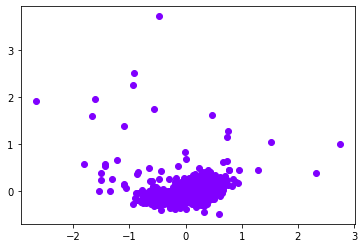

In [ ]:
dic = {}
k = 20
x = np.arange(k)
ys = [i+x+(i*x)**2 for i in range(k)]

colors = cm.rainbow(np.linspace(0, 1, len(ys)))
for i in range(0,k):
    print("number of datasets of cluster ",i," = ",cluster_labels[cluster_labels == i].shape[0])
    print("color of cluster",i," is ",colors[i])
    dic[i] = pca_values[cluster_labels == i]
    plt.scatter(dic[i][:,0],dic[i][:,1],color = colors[i])

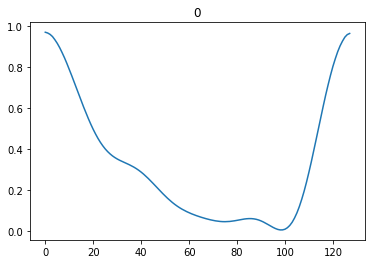

In [ ]:
index = 0
for i in kmeans.cluster_centers_:
  plt.figure();
  plt.plot(i);
  plt.title(str(index))
  index += 1

In [ ]:
for i in np.where(cluster_labels == 6)[0][:10]:
  x = np.concatenate([ppg_beats.iloc[i,:].values,ppg_beats.iloc[i+1,:].values])
  #print(beats_intervals.iloc[i,:])
  plt.figure();
  plt.plot(ppg_beats.iloc[i,:]);
  """plt.figure();
  plt.plot(x);"""

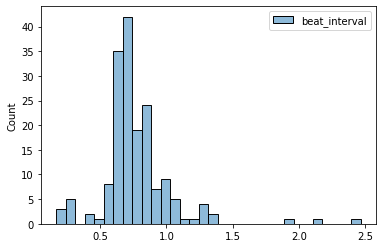

In [ ]:
sns.histplot(beats_intervals.iloc[cluster_labels == 6 ,:])

In [ ]:
total_outliers = 0 
for id in range(1,20):
  print("="*30)
  print("ID = ",id)
  
  number_of_outliers = 0
  id_beats = np.where(persons_id.values == id)[0]
  print("number of beats for person number ",id,"is ",id_beats.shape[0])
  
  for i in np.where(beats_intervals.iloc[id_beats,:]<hr(id)[0]-0.21)[0]:
    #x = np.concatenate([ppg_beats.iloc[i,:].values,ppg_beats.iloc[i+1,:].values])
    number_of_outliers +=1 
    total_outliers +=1
    #print(beats_intervals.iloc[i,:])
    plt.figure();
    plt.plot(ppg_beats.iloc[i,:]);
    plt.title(str(id))
    #plt.figure();
    #plt.plot(x);
  print("number of outliers is larger = ",number_of_outliers)
  print("="*30)
print("TOTAL NUMBER OF OUTLIERS = ",total_outliers)
"""  number_of_outliers = 0
  for i in np.where(beats_intervals.iloc[:500,:]<hr(id)[0]-0.2)[0]:
    #x = np.concatenate([ppg_beats.iloc[i,:].values,ppg_beats.iloc[i+1,:].values])
    number_of_outliers +=1 
    #print(beats_intervals.iloc[i,:])
    plt.figure();
    plt.plot(ppg_beats.iloc[i,:]);
    #plt.figure();
    #plt.plot(x);
  print("number of outliers is smaller = ",number_of_outliers)"""

distances 

0>>> no outliers

1>>>3.5

2>>> no outliers

3>>>>3.2

4>>> no outliers

5>>>>> no

6>>>>> 3.2

7>>>




In [ ]:
df_clean = pd.DataFrame(columns = np.arange(128) )
cluster_df = pd.DataFrame(data = ppg_beats.loc[cluster_labels == cluster_id],columns = np.arange(128))

df_clean = pd.concate([df_clean , cluster_df],axis = 0,ignore_index =True )

threshold of outliers distance is  2
(13,)
148
distanc from center =  2.678948350615865
67
distanc from center =  2.1534898916756147
141
distanc from center =  2.729555630010178
168
distanc from center =  2.252085676374956
148
distanc from center =  2.678948350615865
141
distanc from center =  2.729555630010178
141
distanc from center =  2.729555630010178
148
distanc from center =  2.678948350615865
622
distanc from center =  2.965680250784015
141
distanc from center =  2.729555630010178
622
distanc from center =  2.965680250784015
146
distanc from center =  2.8442101920439966
142
distanc from center =  3.6388420281958673


<Figure size 432x288 with 0 Axes>

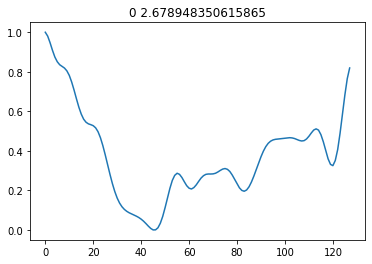

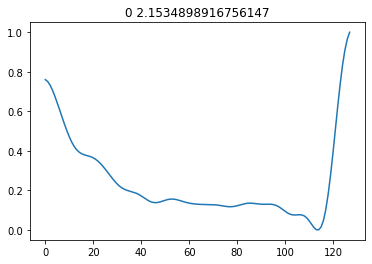

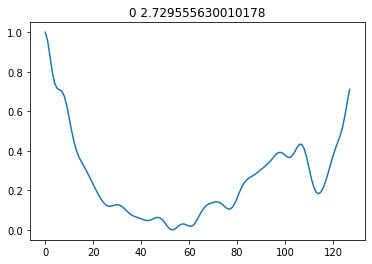

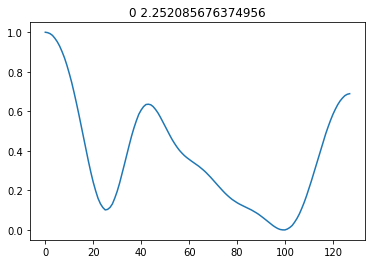

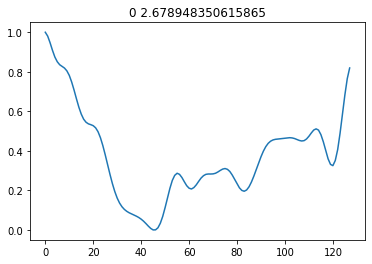

...

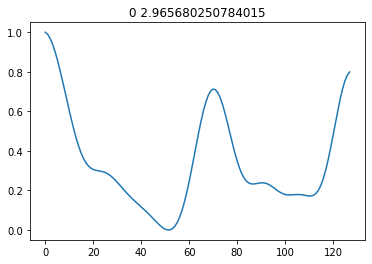

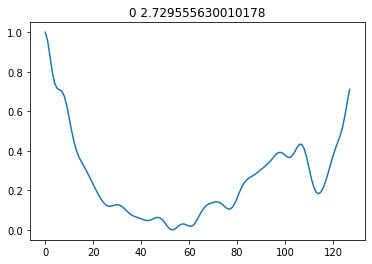

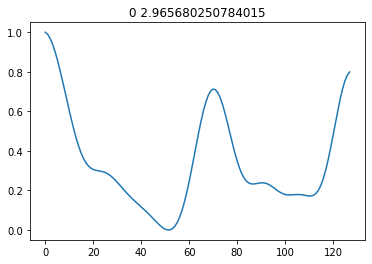

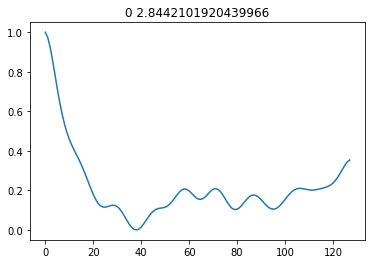

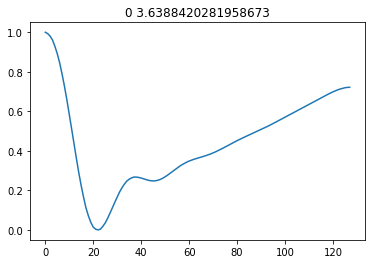

In [ ]:
outliers_fraction = 0.05
cluster_id =0
df = pd.DataFrame()

# get the distance between each point and its nearest centroid. The biggest distances are considered as anomaly
distance = getDistanceByPoint(ppg_beats.loc[cluster_labels == cluster_id].values , kmeans,0)#just a series contain distance between each point and its center
number_of_outliers = int(outliers_fraction*len(distance))#allowed number of outliers from total datasets

threshold = 2#distance.nlargest(number_of_outliers).min() # obtain the threshold 

print("threshold of outliers distance is ",threshold)
# anomaly1 contain the anomaly result of the above method Cluster (0:normal, 1:anomaly)
df['anomaly1'] = (distance >= threshold).astype(int)


"""
fig, ax = plt.subplots(figsize=(10,6))
colors = {0:'blue', 1:'red'}
ax.scatter(pca_values[cluster_labels == cluster_id,0], pca_values[cluster_labels == cluster_id,1], c=df["anomaly1"].apply(lambda x: colors[x]))
plt.xlabel('principal feature1')
plt.ylabel('principal feature2')
plt.show();

"""



outliers_indexes = np.where(df.values == 1)[0]

print(outliers_indexes.shape)
index = np.random.randint(0,outliers_indexes.shape[0],outliers_indexes.shape[0])
plt.figure();
clusters = np.zeros(20)
for i in index:
  clusters[cluster_labels[outliers_indexes[i]]] +=1
  print(outliers_indexes[i])
  print("distanc from center = ",distance[outliers_indexes[i]])
  plt.figure();#plt.subplot(2,5,f+1)
  plt.plot(ppg_beats.loc[cluster_labels == cluster_id].iloc[outliers_indexes[i],:]);
  plt.title(str(cluster_labels[cluster_labels == cluster_id][outliers_indexes[i]]) + " " + str(distance[outliers_indexes[i]]))

In [ ]:
outliers_indexes_lst = []
outliers_indexes_lst.append(np.where( cluster_labels == 8 )[0] )
outliers_indexes_lst.append(np.where( cluster_labels == 18 )[0] )
outliers_indexes_lst.append(np.where( cluster_labels == 9 )[0] )

In [ ]:
outliers_indexes_lst

[array([  140,   622,  2565,  2752,  2948,  2949,  2985,  6315,  6603,
         6932,  8015,  8940,  9095,  9160,  9187,  9237,  9247,  9356,
         9427,  9578,  9689,  9739,  9897, 11487, 11560, 11596, 11610,
        11650, 11700, 11742, 11797, 11837, 11947, 12007, 13181, 14292,
        14296, 14317, 14329, 14368, 14487, 14492, 14494, 14553, 14562,
        14572, 14581, 14587, 14638, 14662, 14732, 14747, 14775, 14776,
        14786, 14823, 14906, 14926, 14966, 15741, 15853, 15870, 16125,
        16140, 16164, 16165, 16182, 16206, 16242, 16294, 16296, 16313,
        16361, 16371, 16425, 16514, 16516, 16560, 16562, 16596, 16636,
        16673, 16683, 16702, 16718, 16733, 16743, 16784, 16819, 16844,
        16847, 16854, 16863, 16881, 16888, 16895, 16910, 16925, 16946,
        17021, 17023, 17059, 17078, 17131, 17145, 17213, 17244, 17291,
        17495, 17515, 17533, 17635, 17642, 17657, 17747, 18291, 18296,
        19083, 19087, 19291, 19512, 19709, 19871, 20322, 20587, 21161,
      

In [ ]:
np.where(cluster_labels[cluster_labels == cluster_id][(distance >= threshold).astype(int)])[0]

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 18

In [ ]:
ppg_beats.loc[cluster_labels == cluster_id].iloc[outliers_indexes[i],:]

0      0.000000
1      0.005576
2      0.011151
3      0.017069
4      0.023672
         ...   
123    0.322928
124    0.301113
125    0.279299
126    0.272027
127    0.272027
Name: 30426, Length: 128, dtype: float64

In [ ]:
distance.max(),distance.min(),distance.mean()

(7.410523894365633, 0.5712210120107623, 1.8452680084257056)

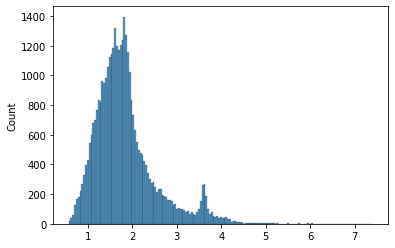

In [ ]:
sns.histplot(distance)

In [ ]:
pd.DataFrame(data = cluster_labels , columns = ['cluster_labels']).to_csv("/content/gdrive/MyDrive/csv_beats_ppg_based_9_12_2022/cluster_labels.csv")

In [ ]:
pd.DataFrame(data = distance ,
             columns = ['distances']).to_csv("/content/gdrive/MyDrive/csv_beats_ppg_based_9_12_2022/distance.csv")

In [ ]:
pd.DataFrame(data = kmeans.cluster_centers_ ).to_csv("/content/gdrive/MyDrive/csv_beats_ppg_based_9_12_2022/cluster_centers.csv")